# Generative Models
***

**ITMO University, Autumn 2022, MSc course**


## Assignment 1

***


*Authored by Arip Asadulaev & Manh Lab*

*Adapted by Alexander Panfilov*

***


The assignment is split into two parts: at first, you will implement classical GAN for the MNIST dataset, and after, you will enhance your results with DCGAN and the CIFAR10 dataset. 

Good luck!

## 1. GAN
*Source: <a href="https://arxiv.org/pdf/1406.2661.pdf" target="_blank">Goodfellow, Ian J., et al. "Generative Adversarial Networks." arXiv preprint arXiv:1406.2661 (2014)</a>.*

In 2014, Ian Goodfellow and his colleagues at the University of Montreal published a stunning paper introducing the world to GANs, or generative adversarial networks. The models play two distinct (literally, adversarial) roles. Given some real data set $\mathcal{X}$, $G$ is the generator, trying to create fake data that looks just like the genuine data, while $D$ is the discriminator, getting data from either the real set or $G$ and labeling the difference.

Goodfellow’s metaphor (and a fine one it is) was that $G$ was like a team of forgers trying to match real paintings with their output, while $D$ was the team of detectives trying to tell the difference. (Except in this case, the forgers $G$ never get to see the original data — only the judgments of $D$. They’re like blind forgers.)

<img src="https://production-media.paperswithcode.com/methods/gan.jpeg" style="display=block; margin:auto"/>
<p style="text-align: center">
    <b>Picture taken from the <a href="https://paperswithcode.com/method/gan" target="_blank">paperswithcode</a> website. There you can find a whole bunch of papers on GANs with implementation.</b>
</p>

In this part, we are going to implement classical GAN. You can find a rough plan on how to do it below; however, it is not mandatory to stick with it precisely but one might expect some questions related to the listed steps. Feel free to adapt provided code!

- Define the parameters
- Load the data (with transforms and normalization)
- Denormalize for visual inspection of samples
- Define the Discriminator network, the Generator network
- Study the activation function: Leaky ReLU
- Explain the output activation function: Tanh, Sigmoid
- Look at some sample outputs
- Define losses, optimizers and helper functions for training
     - For Discriminator
     - For Generator
- Train the model
- Save intermediate generated images to file
- Look at some outputs
- Save the models

### Imports

In [ ]:
import os

import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import matplotlib.animation as animation
from torch.utils.data import DataLoader
from torch.optim import Adam
from PIL import Image
from torchvision import transforms
from torchvision.datasets import CIFAR10, MNIST
from torchvision.transforms import Compose, Normalize, ToTensor
from torchvision.utils import save_image, make_grid
from IPython.display import HTML


%matplotlib inline
plt.style.use("ggplot")

### Define parameters & data loading 

In [ ]:
class CFG:
  hidden_size = 256
  batch_size = 100
  LR = 0.0002
  num_epochs = 300
  sample_dir = "./images"
  latent_size = 64  # input random input vector latent
  image_size = 28
  image_pixels = image_size * image_size # flatten
  device = "cuda" if torch.cuda.is_available() else "cpu"

if not os.path.exists(CFG.sample_dir):
    os.makedirs(CFG.sample_dir)
## Define the dataset
mnist_dataset = MNIST(
    root="data",
    train=True,
    download=True,
    transform=Compose([ToTensor(), Normalize(mean=(0.5,), std=(0.5,))]),
)

Label:  5


(array([55.,  4.,  3.,  0.,  3.,  2.,  1.,  0.,  1.,  3.,  1.,  3.,  2.,
         1., 21.]),
 array([-1.        , -0.86771244, -0.7354248 , -0.60313725, -0.47084966,
        -0.3385621 , -0.20627451, -0.07398693,  0.05830066,  0.19058824,
         0.32287583,  0.4551634 ,  0.587451  ,  0.71973854,  0.85202616,
         0.9843137 ], dtype=float32),
 <a list of 15 Patch objects>)

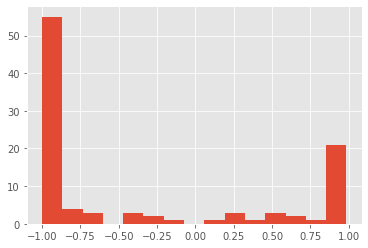

In [ ]:
img, label = mnist_dataset[0]
print("Label: ", label)
plt.hist(img[:, 5:15, 5:15].flatten(), bins=15)

In [ ]:
# denormalization image from range (-1)-1 to range 0-1 to display it
def denorm(x):
    return (x + 1) / 2

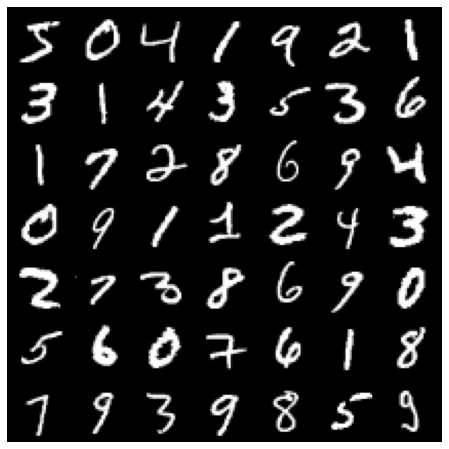

In [ ]:
# show image sample with matplotlib
to_show =[]
for i in range(49):
  to_show.append(mnist_dataset[i][0])

plt.figure(figsize=(8, 8))
plt.axis("off")
plt.imshow(make_grid(torch.stack(to_show), nrow=7, normalize=True).permute(1, 2, 0), cmap='gray');

In [ ]:
# define the dataloader
data_loader = DataLoader(mnist_dataset, batch_size=CFG.batch_size, num_workers=2)

### GAN implementation

GAN consists of two deep networks, a generator ($G$) and a discriminator ($D$). The generator creates images before learning it. Since the discriminator is a binary classification model, we can use the binary cross-entropy loss function to quantify how well it can distinguish between real and generated images.

In [ ]:
class Generator(nn.Module):
    def __init__(self, latent_size, image_pixels, hidden_size):
        super(Generator, self).__init__()
        ## set a linear layer with input size is latent_size and output size is hidden_size
        self.linear1 = nn.Linear(latent_size, hidden_size)

        # set a linear layer with input size is hidden_size and output size is hidden_size
        self.linear2 = nn.Linear(hidden_size, hidden_size)

        # set a linear layer with input size is hidden_size and output size is image_pixels
        self.linear3 = nn.Linear(hidden_size, image_pixels)

    def forward(self, x):
        # forward x -> linear1 -> relu -> linear2 -> relu -> linear3 -> tanh
        x = F.leaky_relu(self.linear1(x), 0.2)
        x = F.leaky_relu(self.linear2(x), 0.2)
        x = torch.tanh(self.linear3(x))
        return x


class Discriminator(nn.Module):
    def __init__(self, image_pixels, hidden_size):
        super(Discriminator, self).__init__()
        ## set a linear layer with input size is image_pixels and output size is hidden_size
        self.linear1 = nn.Linear(image_pixels, hidden_size)

        # set a linear layer with input size is hidden_size and output size is hidden_size
        self.linear2 = nn.Linear(hidden_size, hidden_size)

        # set a linear layer with input size is hidden_size and output size is 1
        self.linear3 = nn.Linear(hidden_size, 1)

    def forward(self, x):
        # forward x -> linear1 -> relu -> linear2 -> relu -> linear3 -> sigmoid
        x = F.leaky_relu(self.linear1(x), 0.2)
        x = F.leaky_relu(self.linear2(x), 0.2)
        x = torch.sigmoid(self.linear3(x))
        return x

### Create the Generator and Discriminator

In [ ]:
# create new Generator model
G = Generator(CFG.latent_size, CFG.image_pixels, CFG.hidden_size)
print(G)

# create new Discriminator model
D = Discriminator(CFG.image_pixels, CFG.hidden_size)
print(D)

Generator(
  (linear1): Linear(in_features=64, out_features=256, bias=True)
  (linear2): Linear(in_features=256, out_features=256, bias=True)
  (linear3): Linear(in_features=256, out_features=784, bias=True)
)
Discriminator(
  (linear1): Linear(in_features=784, out_features=256, bias=True)
  (linear2): Linear(in_features=256, out_features=256, bias=True)
  (linear3): Linear(in_features=256, out_features=1, bias=True)
)


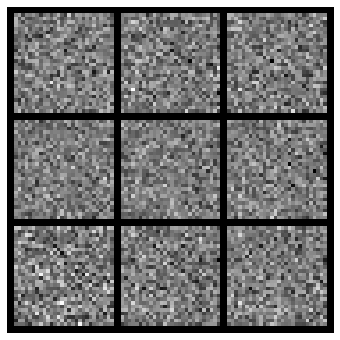

In [ ]:
# show the output of model
y = G(torch.randn(9, CFG.latent_size)).detach().view(-1, 1, CFG.image_size, CFG.image_size)

plt.figure(figsize=(6, 6))
plt.axis("off")
plt.imshow(make_grid(y, nrow=3, normalize=True).permute(1, 2, 0), cmap='gray');

In [ ]:
# define the criterion is nn.BCELoss()
criterion = nn.BCELoss()

## Define the optimizer for generator and discrimator
g_optimizer = Adam(G.parameters(), CFG.LR)
d_optimizer = Adam(D.parameters(), CFG.LR)

Discriminator Training

In [ ]:
def train_discriminator(D_optimizer, D_model, G_model, images, latent_size, device):
  
    # Create the labels which are later used as input for the BCE loss
    batch_size = images.shape[0]
    real_labels = torch.ones(batch_size).to(device)
    fake_labels = torch.zeros(batch_size).to(device)

    D_optimizer.zero_grad()
    
    outputs = D_model(images)
    # Loss for real images
    real_score = outputs.view(-1)
    real_loss = criterion(real_score, real_labels)
    real_loss.backward()

    # Loss for fake images
    z = torch.randn(batch_size, latent_size).to(device)
    fake_images = G_model(z)
    outputs = D_model(fake_images)

    fake_score = outputs.view(-1)
    fake_loss = criterion(fake_score, fake_labels)
    fake_loss.backward()

    d_loss = (real_loss + fake_loss) * 0.5
    D_optimizer.step()
    
    return d_loss, real_score, fake_score

Generator Training

In [ ]:
def train_generator(G_optimizer, D_model, G_model, latent_size, device):
    # Generate fake images and calculate loss
    batch_size = images.shape[0]
    z = torch.Tensor(np.random.normal(0, 1, (batch_size, latent_size))).to(device)

    G_optimizer.zero_grad()

    fake_images = G_model(z)
    labels = torch.ones(batch_size).to(device)

    g_loss = criterion(D_model(fake_images).view(-1), labels)

    g_loss.backward()
    G_optimizer.step()

    return g_loss, fake_images

### Start the training proccess

In [ ]:
# function to save the sample output of generator
sample_vectors = torch.Tensor(np.random.normal(0, 1, (CFG.batch_size, CFG.latent_size))).to(CFG.device)

def save_fake_images_mnist(G_model, index):
    fake_images = G_model(sample_vectors)
    fake_images = fake_images.reshape(fake_images.size(0), 1, CFG.image_size, CFG.image_size)
    fake_fname = "fake_images-{0:0=4d}.png".format(index)
    print("Saving", fake_fname)
    save_image(denorm(fake_images), os.path.join(CFG.sample_dir, fake_fname), nrow=10)

In [ ]:
%%time
total_step = len(data_loader)
d_losses, g_losses, real_scores, fake_scores = [], [], [], []
G.to(CFG.device)
D.to(CFG.device)
for epoch in range(CFG.num_epochs):
    for i, (images, _) in enumerate(data_loader):
        # Load a batch & transform to vectors
        images = images.reshape(CFG.batch_size, -1).to(CFG.device)

        # Train the discriminator
        d_loss, real_score, fake_score = train_discriminator(d_optimizer, D, G, images, CFG.latent_size, CFG.device)

        # Train the generator
        g_loss, fake_images = train_generator(g_optimizer, D, G, CFG.latent_size, CFG.device)

        # Inspect the losses
        if (i + 1) % 200 == 0:
            d_losses.append(d_loss.item())
            g_losses.append(g_loss.item())
            real_scores.append(real_score.mean().item())
            fake_scores.append(fake_score.mean().item())
            print(
                "Epoch [{}/{}], Step [{}/{}], d_loss: {:.4f}, g_loss: {:.4f}, D(x): {:.2f}, D(G(z)): {:.2f}".format(
                    epoch,
                    CFG.num_epochs,
                    i + 1,
                    total_step,
                    d_loss.item(),
                    g_loss.item(),
                    real_score.mean().item(),
                    fake_score.mean().item(),
                )
            )
    # Sample and save images
    save_fake_images_mnist(G, epoch + 1)

Epoch [0/300], Step [200/600], d_loss: 0.5561, g_loss: 1.9747, D(x): 0.58, D(G(z)): 0.25
Epoch [0/300], Step [400/600], d_loss: 0.3126, g_loss: 2.5457, D(x): 0.78, D(G(z)): 0.23
Epoch [0/300], Step [600/600], d_loss: 0.1759, g_loss: 3.1627, D(x): 0.84, D(G(z)): 0.11
Saving fake_images-0001.png
Epoch [1/300], Step [200/600], d_loss: 0.2694, g_loss: 3.2625, D(x): 0.76, D(G(z)): 0.12
Epoch [1/300], Step [400/600], d_loss: 0.4034, g_loss: 2.3893, D(x): 0.70, D(G(z)): 0.20
Epoch [1/300], Step [600/600], d_loss: 0.2017, g_loss: 2.8569, D(x): 0.83, D(G(z)): 0.13
Saving fake_images-0002.png
Epoch [2/300], Step [200/600], d_loss: 0.2038, g_loss: 2.5713, D(x): 0.87, D(G(z)): 0.18
Epoch [2/300], Step [400/600], d_loss: 0.2525, g_loss: 2.9286, D(x): 0.83, D(G(z)): 0.17
Epoch [2/300], Step [600/600], d_loss: 0.3495, g_loss: 2.4915, D(x): 0.72, D(G(z)): 0.18
Saving fake_images-0003.png
Epoch [3/300], Step [200/600], d_loss: 0.4951, g_loss: 2.4523, D(x): 0.67, D(G(z)): 0.20
Epoch [3/300], Step [400/6

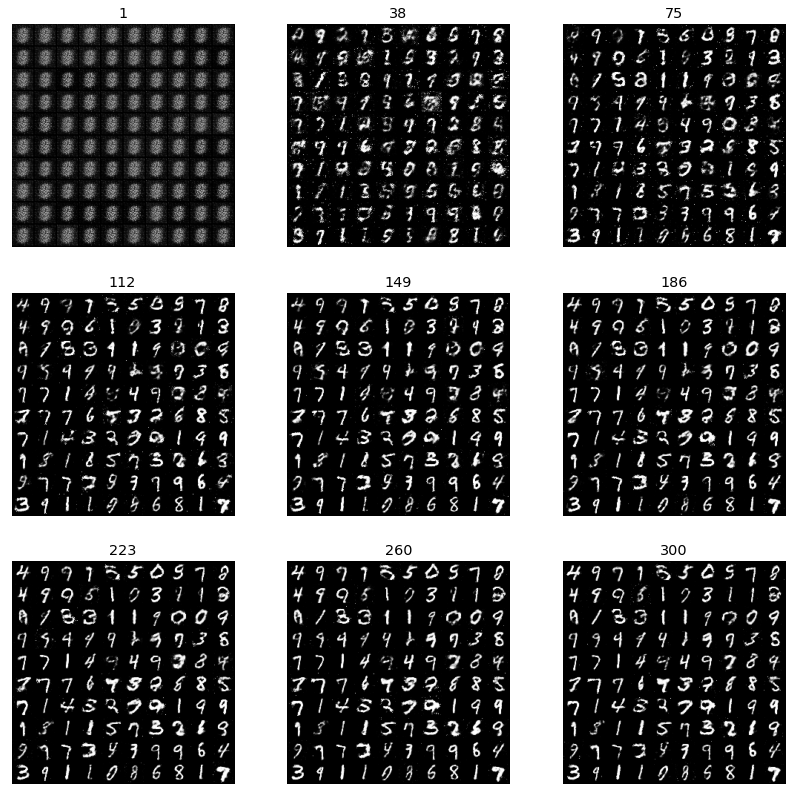

In [ ]:
# show output after epochs training
def read_img(sample_dir, num):
  return mpimg.imread(os.path.join(sample_dir, "fake_images-{0:0=4d}.png".format(num)))

def show_results(sample_dir, num_ehochs):
  images = []
  diff = CFG.num_epochs // 8
  for i in range(1, num_ehochs - diff, diff):
    images.append((read_img(sample_dir, i), i))
  images.append((read_img(sample_dir, num_ehochs), num_ehochs))

  fig = plt.figure(figsize=(14, 14))
  i = 0
  for img, label in images:
    i += 1
    ax = fig.add_subplot(3, 3, i)
    ax.imshow(img)
    ax.set_title(label)
    ax.set_xticks([])
    ax.set_yticks([])

show_results(CFG.sample_dir, CFG.num_epochs)

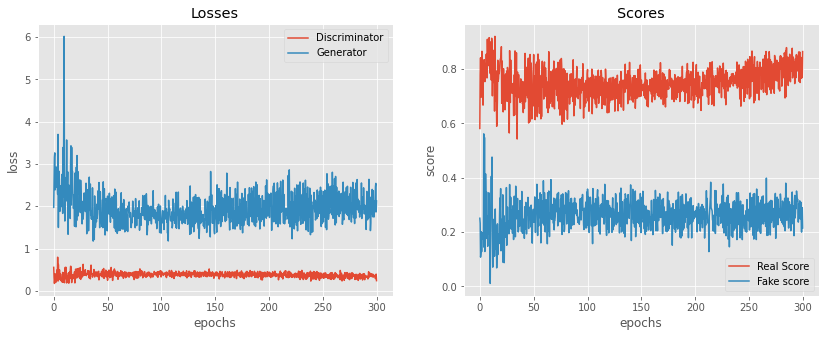

In [ ]:
# show the discrimator loss and generator loss
fig = plt.figure(figsize=(14, 5))
steps = [i / 3 for i in range(len(d_losses))]

ax = fig.add_subplot(1, 2, 1)
ax.plot(steps, d_losses, "-")
ax.plot(steps, g_losses, "-")
ax.set_xlabel("epochs")
ax.set_ylabel("loss")
ax.legend(["Discriminator", "Generator"])
ax.set_title("Losses")

ax = fig.add_subplot(1, 2, 2)
ax.plot(steps, real_scores, "-")
ax.plot(steps, fake_scores, "-")
ax.set_xlabel("epochs")
ax.set_ylabel("score")
ax.legend(["Real Score", "Fake score"])
ax.set_title("Scores");

## 2. DCGAN

*Source: <a href="https://arxiv.org/pdf/1511.06434v2.pdf" target="_blank">Radford, Alec, Luke Metz, and Soumith Chintala. "Unsupervised representation learning with deep convolutional generative adversarial networks." arXiv preprint arXiv:1511.06434 (2015)</a>.*

The goal of this part is to enhance your results achieved in the part one with DCGAN. Feel free to reuse your code, improve architecture or training scheme, etc.

In [ ]:
class CFG:
    batch_size = 128
    num_epochs = 50
    workers = 4
    seed = 2021
    image_size = 64
    download = True
    dataroot = "data"
    nc = 3  ## number chanels
    ngf = 64  # Size of feature maps in generator
    nz = 100  # latent random input vector
    ndf = 64  # Size of feature maps in discriminator
    lr = 0.0001
    betas = (0.5, 0.999)
    device = "cuda" if torch.cuda.is_available() else "cpu"
    sample_dir = "./dc-images/"


if not os.path.exists(CFG.sample_dir):
    os.makedirs(CFG.sample_dir)

cifar_dataset = CIFAR10(
    root=CFG.dataroot,
    download=CFG.download,
    transform=transforms.Compose(
        [
            transforms.Resize([CFG.image_size, CFG.image_size]),
            transforms.ToTensor(),
            transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
        ]
    ),
)

Files already downloaded and verified


Label:  6


(array([ 3.,  6., 52., 36.,  6.,  4., 12., 40., 40.,  7.,  2.,  6., 22.,
        32., 32.]),
 array([-0.8745098 , -0.8112418 , -0.74797386, -0.68470585, -0.6214379 ,
        -0.5581699 , -0.49490196, -0.43163398, -0.36836597, -0.305098  ,
        -0.24183004, -0.17856206, -0.11529408, -0.0520261 ,  0.01124188,
         0.07450986], dtype=float32),
 <a list of 15 Patch objects>)

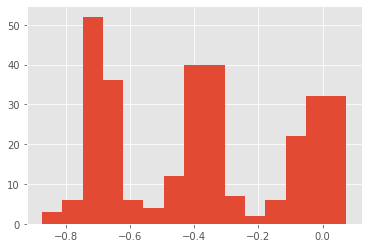

In [ ]:
img, label = cifar_dataset[0]
print("Label: ", label)
plt.hist(img[:, 5:15, 5:15].flatten(), bins=15)

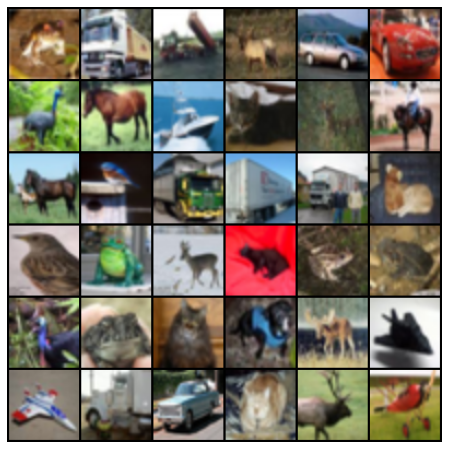

In [ ]:
to_show =[]
for i in range(36):
  to_show.append(cifar_dataset[i][0])

plt.figure(figsize=(8, 8))
plt.axis("off")
plt.imshow(make_grid(torch.stack(to_show), nrow=6, normalize=True).permute(1, 2, 0));

In [ ]:
# create the dataloader
data_loader = DataLoader(cifar_dataset, batch_size=CFG.batch_size, num_workers=2)

### DCGAN implementation

In [ ]:
class DCGenerator(nn.Module):
    def __init__(self, nc, nz, ngf):
        # ConvTranspose2d - BatchNorm - Relu -ConvTranspose2d - BatchNorm - Relu -ConvTranspose2d - BatchNorm - Relu
        # ConvTranspose2d - BatchNorm - Relu - ConvTranspose2d - Tanh
        super(DCGenerator, self).__init__()

        self.conv1 = nn.ConvTranspose2d(nz, ngf * 8, kernel_size=4, stride=1, padding=0, bias=False)
        self.batch1 = nn.BatchNorm2d(ngf * 8)
        
        self.conv2 = nn.ConvTranspose2d(ngf * 8, ngf * 4, kernel_size=4, stride=2, padding=1, bias=False)
        self.batch2 = nn.BatchNorm2d(ngf * 4)
        
        self.conv3 = nn.ConvTranspose2d(ngf * 4, ngf * 2, kernel_size=4, stride=2, padding=1, bias=False)
        self.batch3 = nn.BatchNorm2d(ngf * 2)

        self.conv4 = nn.ConvTranspose2d(ngf * 2, ngf, kernel_size=4, stride=2, padding=1, bias=False)
        self.batch4 = nn.BatchNorm2d(ngf)

        self.conv5 = nn.ConvTranspose2d(ngf, nc, kernel_size=4, stride=2, padding=1, bias=False)

    def forward(self, x):
        x = x.view((x.shape[0], x.shape[1], 1, 1))
        x = torch.relu(self.batch1(self.conv1(x)))
        x = torch.relu(self.batch2(self.conv2(x)))
        x = torch.relu(self.batch3(self.conv3(x)))
        x = torch.relu(self.batch4(self.conv4(x)))
        return torch.tanh(self.conv5(x))


class DCDiscriminator(nn.Module):
    def __init__(self, nc, ndf):
        # conv2d - leaky - conv2d - batchnorm - leaky - conv2d - batchnorm - leaky - conv - batchnorm - leaky - conv2d
        super(DCDiscriminator, self).__init__()
        
        self.conv5 = nn.Conv2d(nc, ndf, kernel_size=4, stride=2, padding=1, bias=False)

        self.conv4 = nn.Conv2d(ndf, ndf * 2, kernel_size=4, stride=2, padding=1, bias=False)
        self.batch4 = nn.BatchNorm2d(ndf * 2)

        self.conv3 = nn.Conv2d(ndf * 2, ndf * 4, kernel_size=4, stride=2, padding=1, bias=False)
        self.batch3 = nn.BatchNorm2d(ndf * 4)

        self.conv2 = nn.Conv2d(ndf * 4, ndf * 8, kernel_size=4, stride=2, padding=1, bias=False)
        self.batch2 = nn.BatchNorm2d(ndf * 8)

        self.conv1 = nn.Conv2d(ndf * 8, 1, kernel_size=4, stride=1, padding=0, bias=False)

    def forward(self, x):
        x = F.leaky_relu(self.conv5(x), 0.2)
        x = F.leaky_relu(self.batch4(self.conv4(x)), 0.2)
        x = F.leaky_relu(self.batch3(self.conv3(x)), 0.2)
        x = F.leaky_relu(self.batch2(self.conv2(x)), 0.2)
        return torch.sigmoid(self.conv1(x))

In [ ]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# create new Generator model
DCG = DCGenerator(CFG.nc, CFG.nz, CFG.ngf)
DCG.apply(weights_init)
print(DCG)

# create new Discriminator model
DCD = DCDiscriminator(CFG.nc, CFG.ndf)
DCD.apply(weights_init)
print(DCD)

DCGenerator(
  (conv1): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
  (batch1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv2): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (batch2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv3): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (batch3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv4): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (batch4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv5): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
)
DCDiscriminator(
  (conv5): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (conv4): Conv2d(64, 128, ke

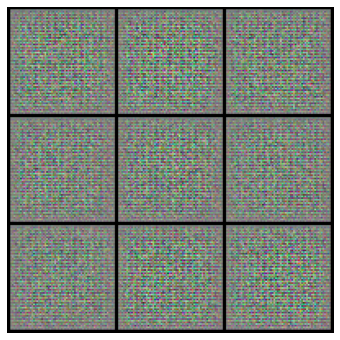

In [ ]:
# show the output of model
y = DCG(torch.randn(9, CFG.nz)).detach()

plt.figure(figsize=(6, 6))
plt.axis("off")
plt.imshow(make_grid(y, nrow=3, normalize=True).permute(1, 2, 0));

In [ ]:
# define the criterion is nn.BCELoss()
criterion = nn.BCELoss()

## Define the optimizer for generator and discrimator
dcg_optimizer = Adam(DCG.parameters(), CFG.lr, betas=CFG.betas)
dcd_optimizer = Adam(DCD.parameters(), CFG.lr, betas=CFG.betas)

In [ ]:
# feel free to reuse your training functions

### Start the training proccess

In [ ]:
sample_vectors = torch.randn(100, CFG.nz, 1, 1).to(CFG.device)

def save_fake_images_cifar(DCG_model, index, sample_dir=CFG.sample_dir, batch_size=CFG.batch_size):
    fake_images = DCG_model(sample_vectors)
    fake_images = fake_images.reshape(fake_images.size(0), 3, 64, 64)
    fake_fname = "fake_images-{0:0=4d}.png".format(index)
    print("Saving", fake_fname)
    save_image(
        denorm(fake_images), os.path.join(sample_dir, fake_fname), nrow=10
    )

In [ ]:
%%time
total_step = len(data_loader)
d_losses, g_losses, real_scores, fake_scores = [], [], [], []
DCG.to(CFG.device)
DCD.to(CFG.device)
for epoch in range(CFG.num_epochs):
    for i, (images, _) in enumerate(data_loader):
        # Load a batch & transform to vectors
        images = images.to(CFG.device)

        # Train the discriminator
        dcd_loss, real_score, fake_score = train_discriminator(dcd_optimizer, DCD, DCG, images, latent_size=CFG.nz, device=CFG.device)

        # Train the generator
        dcg_loss, fake_images = train_generator(dcg_optimizer, DCD, DCG, latent_size=CFG.nz, device=CFG.device)

        # Inspect the losses
        if (i + 1) % 150 == 0 or (i + 1) == total_step:
            d_losses.append(dcd_loss.item())
            g_losses.append(dcg_loss.item())
            real_scores.append(real_score.mean().item())
            fake_scores.append(fake_score.mean().item())
            print(
                "Epoch [{}/{}], Step [{}/{}], d_loss: {:.4f}, g_loss: {:.4f}, D(x): {:.2f}, D(G(z)): {:.2f}".format(
                    epoch,
                    CFG.num_epochs,
                    i + 1,
                    total_step,
                    dcd_loss.item(),
                    dcg_loss.item(),
                    real_score.mean().item(),
                    fake_score.mean().item(),
                )
            )
    # Sample and save images
    save_fake_images_cifar(DCG, epoch + 1)

Epoch [0/50], Step [150/391], d_loss: 0.0150, g_loss: 8.7990, D(x): 0.99, D(G(z)): 0.02
Epoch [0/50], Step [300/391], d_loss: 0.0207, g_loss: 6.6199, D(x): 0.98, D(G(z)): 0.02
Epoch [0/50], Step [391/391], d_loss: 0.0190, g_loss: 7.1319, D(x): 0.97, D(G(z)): 0.01
Saving fake_images-0001.png
Epoch [1/50], Step [150/391], d_loss: 0.0554, g_loss: 14.0386, D(x): 0.92, D(G(z)): 0.00
Epoch [1/50], Step [300/391], d_loss: 0.0406, g_loss: 7.4117, D(x): 0.95, D(G(z)): 0.01
Epoch [1/50], Step [391/391], d_loss: 0.0391, g_loss: 6.1114, D(x): 0.97, D(G(z)): 0.05
Saving fake_images-0002.png
Epoch [2/50], Step [150/391], d_loss: 0.1470, g_loss: 5.5771, D(x): 0.92, D(G(z)): 0.17
Epoch [2/50], Step [300/391], d_loss: 0.0732, g_loss: 5.5518, D(x): 0.92, D(G(z)): 0.03
Epoch [2/50], Step [391/391], d_loss: 0.1933, g_loss: 4.6089, D(x): 0.77, D(G(z)): 0.02
Saving fake_images-0003.png
Epoch [3/50], Step [150/391], d_loss: 0.0834, g_loss: 4.9381, D(x): 0.92, D(G(z)): 0.07
Epoch [3/50], Step [300/391], d_los

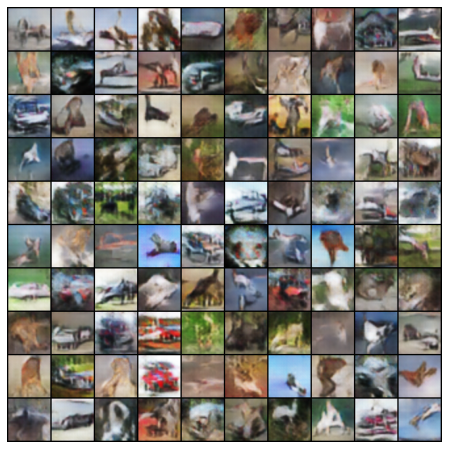

In [ ]:
# show output after epochs training
def read_img(sample_dir, num):
  return mpimg.imread(os.path.join(sample_dir, "fake_images-{0:0=4d}.png".format(num)))

# show your results!
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(read_img(CFG.sample_dir, i + 1), animated=True)] for i in range(50)]
ani = animation.ArtistAnimation(fig, ims, interval=1000, blit=True)

HTML(ani.to_jshtml())

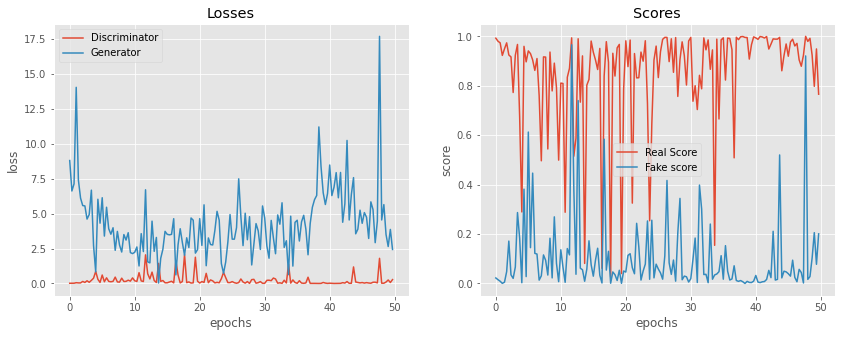

In [ ]:
# show the discrimator loss and generator loss
fig = plt.figure(figsize=(14, 5))
steps = [i / 3 for i in range(len(d_losses))]

ax = fig.add_subplot(1, 2, 1)
ax.plot(steps, d_losses, "-")
ax.plot(steps, g_losses, "-")
ax.set_xlabel("epochs")
ax.set_ylabel("loss")
ax.legend(["Discriminator", "Generator"])
ax.set_title("Losses")

ax = fig.add_subplot(1, 2, 2)
ax.plot(steps, real_scores, "-")
ax.plot(steps, fake_scores, "-")
ax.set_xlabel("epochs")
ax.set_ylabel("score")
ax.legend(["Real Score", "Fake score"])
ax.set_title("Scores");

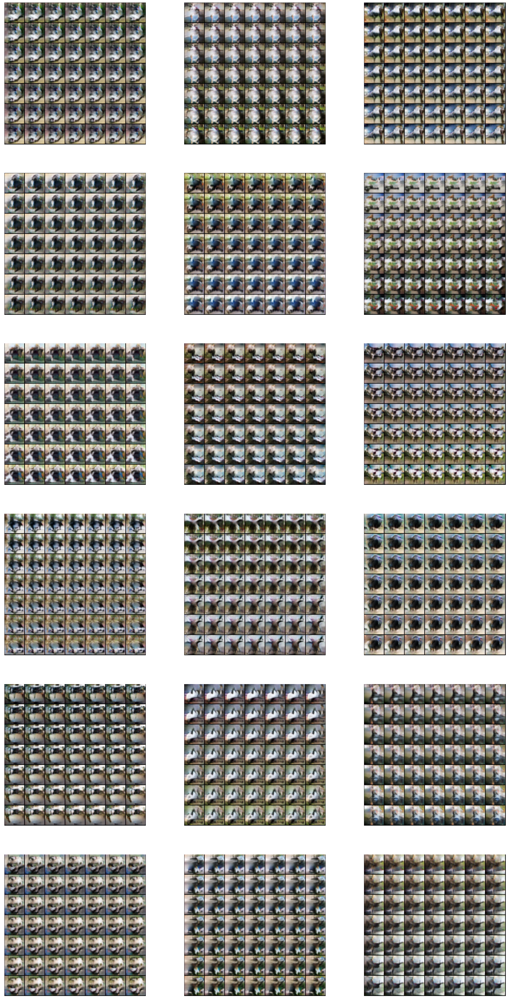

In [ ]:
zs = [torch.Tensor(np.random.normal(0, 1, (CFG.nz))).to(CFG.device) for i in range(18)]
fig = plt.figure(figsize=(25, 50))

i = 0
for i in range(18):
  zis = []
  z = zs[i]
  for zi in np.linspace(-2, 2, 7 * 7):
    z[i] = zi
    zis.append(z.clone().detach())
  
  y = DCG(torch.stack(zis))

  ax = fig.add_subplot(6, 3, i + 1)
  ax.set_xticks([])
  ax.set_yticks([])

  ax.imshow(make_grid(y.cpu(), nrow=7, normalize=True).permute(1, 2, 0));